In [ ]:
!conda install geopandas --y

In [ ]:
!pip install folium

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.ticker as ticker
import seaborn as sns
import geopandas as gpd
import numpy as np

sns.set_style("darkgrid")

# EDA
## Dataset description

This datasets contains Uber Pickups in NYC from April to Septembre 2014 and from January to June 2015. 

The 2014 files have the following columns:
* `Date/Time`
* `Lat`
* `Lon`
* `Base`: The TLC base company code affiliated with the Uber pickup

The 2015 file has the following columns:
* `Dispatching_base_num` : The TLC base company code of the base that dispatched the Uber
* `Pickup_date` : The date and time of the Uber pickup
* `Affiliated_base_num` : The TLC base company code affiliated with the Uber pickup
* `locationID` : The pickup location ID affiliated with the Uber pickup. Details of this location can be found in the file `taxi-zone-lookup.csv`

More details [here](https://www.kaggle.com/datasets/fivethirtyeight/uber-pickups-in-new-york-city)

In [3]:
files_2014 = ['uber-raw-data-apr14.csv', 'uber-raw-data-may14.csv', 'uber-raw-data-jun14.csv', 'uber-raw-data-jul14.csv', 'uber-raw-data-aug14.csv', 'uber-raw-data-sep14.csv']

data_2014 = pd.DataFrame()
for file in files_2014:
    data = pd.read_csv('uber-trip-data/' + file)
    data_2014 = pd.concat([data_2014, data])

    
data_2014.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [4]:
from zipfile import ZipFile

zip_data_2015 = ZipFile('uber-trip-data/uber-raw-data-janjune-15.csv.zip', 'r')
zip_data_2015.extractall('uber-trip-data')

data_2015 = pd.read_csv('uber-trip-data/uber-raw-data-janjune-15.csv')
data_2015 = data_2015.merge(pd.read_csv('uber-trip-data/taxi-zone-lookup.csv'), left_on='locationID', right_on='LocationID', how='left').drop(columns=['locationID'])
data_2015.head()

,Dispatching_base_num,Pickup_date,Affiliated_base_num,LocationID,Borough,Zone
0,B02617,2015-05-17 09:47:00,B02617,141,Manhattan,Lenox Hill West
1,B02617,2015-05-17 09:47:00,B02617,65,Brooklyn,Downtown Brooklyn/MetroTech
2,B02617,2015-05-17 09:47:00,B02617,100,Manhattan,Garment District
3,B02617,2015-05-17 09:47:00,B02774,80,Brooklyn,East Williamsburg
4,B02617,2015-05-17 09:47:00,B02617,90,Manhattan,Flatiron


## Basics statistics

We got lots of data! The 2014 DataFrame contains 4534327 rows and the 2015 one contains 14270478 rows. Luckily, there are not a lot of missing data. Only a few rows don't have a `Affiliated_base_num`in the 2015 DataFrame.
We can also see that the `Date/Time`and `Pickup_date` columns are not in the correct format.
As the files contains lots of rows, we will focus on the 2014 data to make computation time shorter.

In [4]:
data_2014.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4534327 entries, 0 to 1028135
Data columns (total 4 columns):
 #   Column     Non-Null Count    Dtype  
---  ------     --------------    -----  
 0   Date/Time  4534327 non-null  object 
 1   Lat        4534327 non-null  float64
 2   Lon        4534327 non-null  float64
 3   Base       4534327 non-null  object 
dtypes: float64(2), object(2)
memory usage: 173.0+ MB


In [8]:
data_2015.info(verbose=True, show_counts=True)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 14270479 entries, 0 to 14270478
Data columns (total 6 columns):
 #   Column                Non-Null Count     Dtype 
---  ------                --------------     ----- 
 0   Dispatching_base_num  14270479 non-null  object
 1   Pickup_date           14270479 non-null  object
 2   Affiliated_base_num   14108284 non-null  object
 3   LocationID            14270479 non-null  int64 
 4   Borough               14270479 non-null  object
 5   Zone                  14270479 non-null  object
dtypes: int64(1), object(5)
memory usage: 762.1+ MB


### Datetime data wrangling
First we need to convert the `Date/Time`and `Pickup_date`columns into a Timestamp format in order to extract parts of it. Then we will divide the time into 15 minutes bins and affect the pick up to the closest one. 

In [5]:
data_2014['Date/Time'] = pd.to_datetime(data_2014['Date/Time'],format='%m/%d/%Y %H:%M:%S')
data_2014['month'] = data_2014['Date/Time'].dt.month
data_2014['weekday'] = data_2014['Date/Time'].dt.day_name()
data_2014['day'] = data_2014['Date/Time'].dt.day
data_2014['hour'] = data_2014['Date/Time'].dt.hour
data_2014['minute'] = data_2014['Date/Time'].dt.minute
data_2014['date'] = data_2014['Date/Time'].dt.date
data_2014['binned_time'] = data_2014['Date/Time'].dt.round(freq='15min').dt.time

data_2014.head()

,Date/Time,Lat,Lon,Base,month,weekday,day,hour,minute,date,binned_time
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,4,Tuesday,1,0,11,2014-04-01,00:15:00
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,4,Tuesday,1,0,17,2014-04-01,00:15:00
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,4,Tuesday,1,0,21,2014-04-01,00:15:00
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,4,Tuesday,1,0,28,2014-04-01,00:30:00
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,4,Tuesday,1,0,33,2014-04-01,00:30:00


## Exploration
Let's do the data exploration on the 2014 DataFrame

### Rides per month
As we can see there is a upwards trend. Each month the number of rides increase. There were 24% more ride in September compared to August.

In [79]:
pct_change = (data_2014['month'].value_counts().sort_index().pct_change() * 100).round(1)
pct_change = ('+' + pct_change.astype(str)+ '%').replace('+nan%', '')

[Text(0.5, 1.0, 'Number of rides per month')]

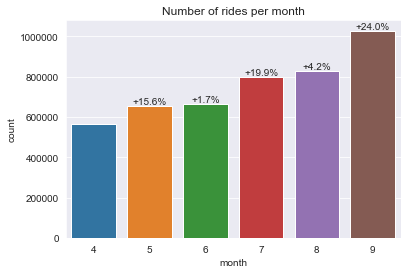

In [80]:
ax = sns.countplot(data=data_2014, x='month')
plt.ticklabel_format(style='plain', axis='y')
ax.bar_label(ax.containers[0],labels=pct_change)
ax.set(title='Number of rides per month')

### Rides per day
We can see some weekly trend shared accross all months. There are always less rides on Sundays. The peak of rides is between Wednesday and Friday. However in Semptember, there seems to be more rides on Saturdays than during the other months.

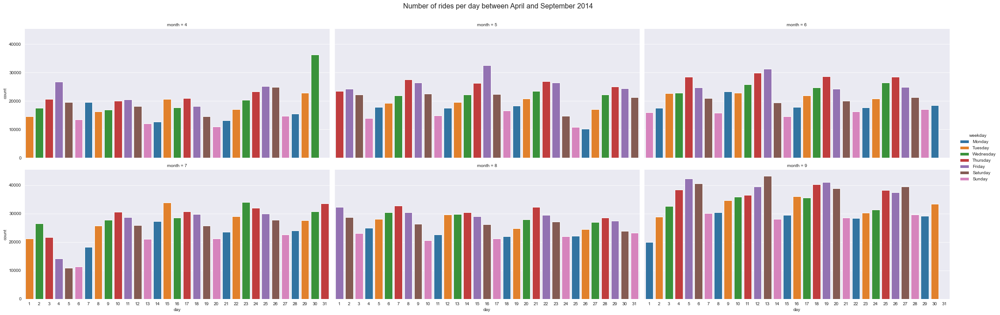

In [81]:
g = sns.FacetGrid(data_2014, col='month', hue='weekday', hue_order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], col_wrap=3, height=5, aspect= 2)
g.map(sns.countplot, 'day', order=list(range(1,32)))
g.add_legend()
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Number of rides per day between April and September 2014', fontsize=16);

### Rides per weekday

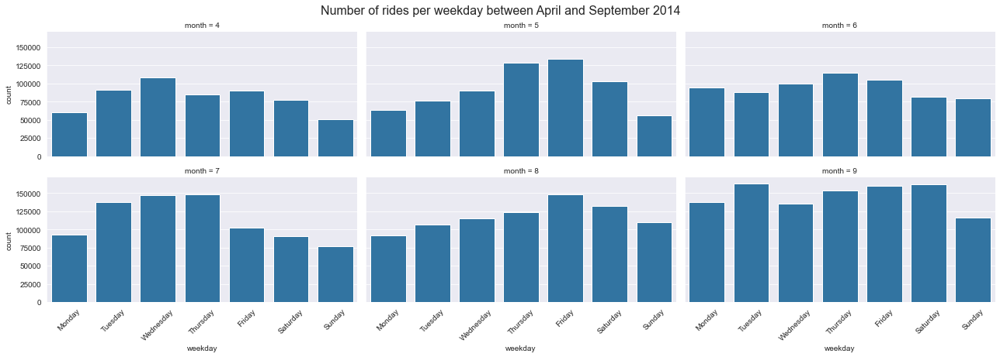

In [17]:
g = sns.FacetGrid(data_2014, col='month', col_wrap=3, height=3, aspect= 2)
g.map(sns.countplot, 'weekday', order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])
g.set_xticklabels(rotation = 45)
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Number of rides per weekday between April and September 2014', fontsize=16);

### Rides per base
We can see an increase for the B02617 and B02764 bases in 6 months time

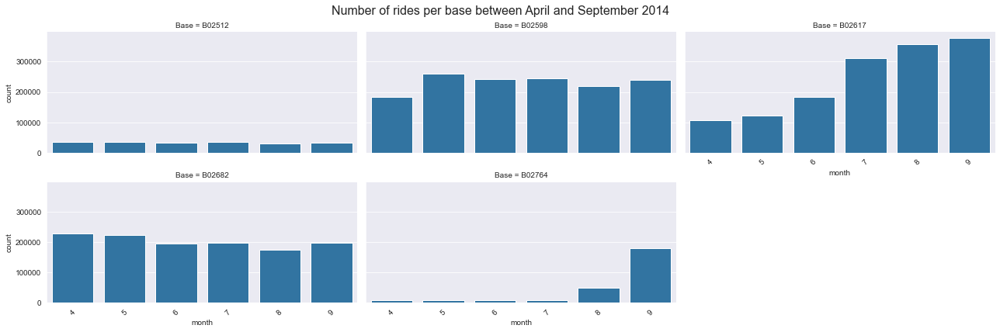

In [86]:
g = sns.FacetGrid(data_2014, col='Base', col_wrap=3, height=3, aspect= 2)
g.map(sns.countplot, 'month', order=data_2014['month'].unique())
g.set_xticklabels(rotation = 45)
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Number of rides per base between April and September 2014', fontsize=16);

### Weekly analysis
Let's dive into a more detailed analysis for the first full week of May (5th to 11th).

In [6]:
may_2014 = data_2014[(data_2014['date'].astype(str) >= '2014-05-05') & (data_2014['date'].astype(str) <= '2014-05-11')]

In [7]:
may_2014_agg = may_2014.groupby(['date','weekday', 'Base', 'binned_time']).count().rename(columns={'Date/Time' : 'total_rides'})['total_rides'].reset_index()
may_2014_agg['binned_time'] = pd.to_datetime(may_2014_agg['binned_time'], format = "%H:%M:%S")
may_2014_agg.loc[~may_2014_agg['weekday'].isin(['Saturday', 'Sunday']), 'day_type'] = 'weekday'
may_2014_agg.loc[may_2014_agg['weekday'].isin(['Saturday', 'Sunday']), 'day_type'] = 'weekend'
may_2014_agg.head()

,date,weekday,Base,binned_time,total_rides,day_type
0,2014-05-05,Monday,B02512,1900-01-01 00:00:00,3,weekday
1,2014-05-05,Monday,B02512,1900-01-01 00:30:00,1,weekday
2,2014-05-05,Monday,B02512,1900-01-01 01:30:00,2,weekday
3,2014-05-05,Monday,B02512,1900-01-01 01:45:00,1,weekday
4,2014-05-05,Monday,B02512,1900-01-01 02:00:00,1,weekday


We can clearly see some differences between weekdays and weekends. The spike between 7 and 9am does not exists during the weekend and the spike around 5 and 6pm is slightly lower. During the weekend the number of rides late evening and during the night is higher. 

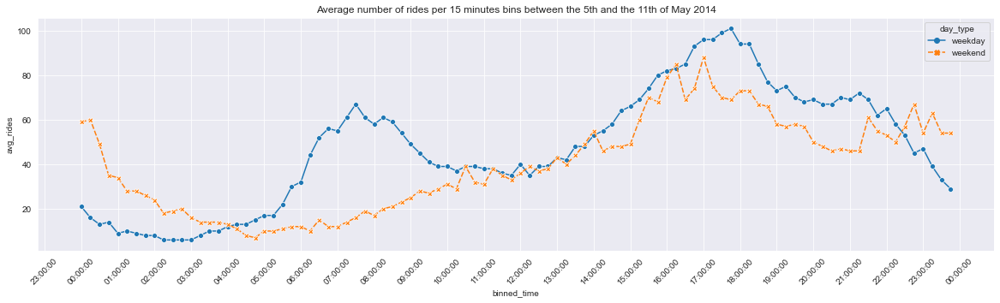

In [8]:
may_2014_agg_daytype = may_2014_agg.groupby(['day_type','binned_time']).mean().round().rename(columns={'total_rides' : 'avg_rides'}).reset_index()

plt.figure(figsize=(20,5))
g = sns.lineplot(data=may_2014_agg_daytype, x='binned_time', y='avg_rides', hue='day_type', style='day_type', markers=True)
g.xaxis.set_major_locator(mdates.HourLocator())
g.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))
plt.xticks(rotation=45)

g.set_title('Average number of rides per 15 minutes bins between the 5th and the 11th of May 2014');

### Analysis per base
If you look at the average number of rides per base, we can see that all the bases follow the same trend.Their peak hours are the same and 

In [9]:
may_2014_agg_daytype_base = may_2014_agg.groupby(['day_type','binned_time','Base']).mean().round().rename(columns={'total_rides' : 'avg_rides'}).reset_index()

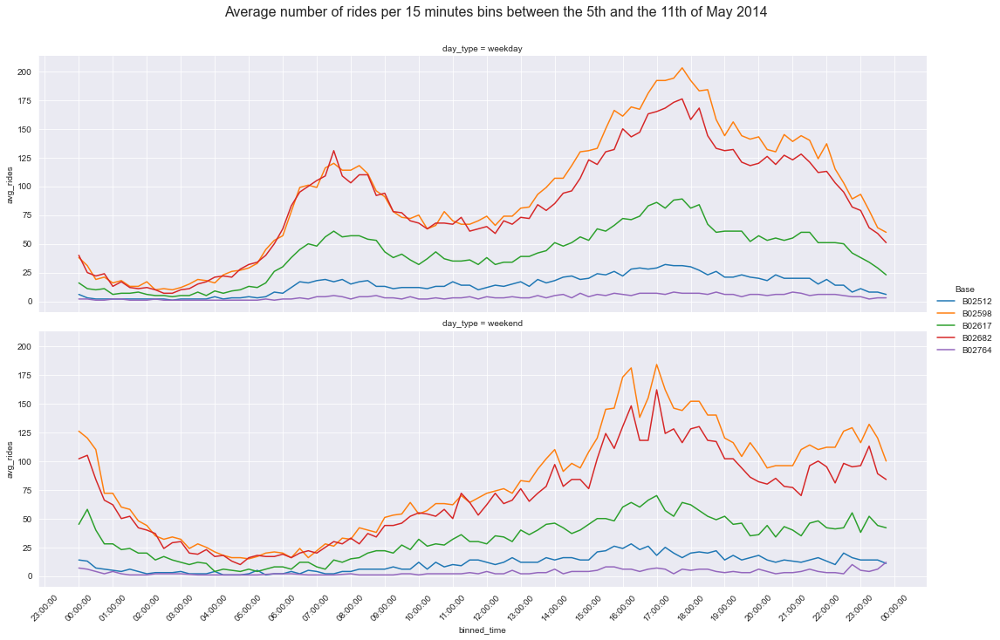

In [10]:
g = sns.FacetGrid(may_2014_agg_daytype_base, row='day_type',hue='Base',  height=5, aspect=3)
g.map(sns.lineplot, 'binned_time','avg_rides')
for ax in g.axes.flat: 
    ax.xaxis.set_major_locator(mdates.HourLocator())
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))
plt.xticks(rotation=45)

g.add_legend()
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle('Average number of rides per 15 minutes bins between the 5th and the 11th of May 2014', fontsize=16);

We can a concentration of points around the center of the graph. 

### A bit of geography
Lets's plot the rides on a scatterplot with the longitude on the x axis and the latitude on the y axis. We can clearly see of very dense zone in the middle of the plot

Text(0.5, 1.0, 'Pickups locations in NYC between the 5th and the 11th of May 2014')

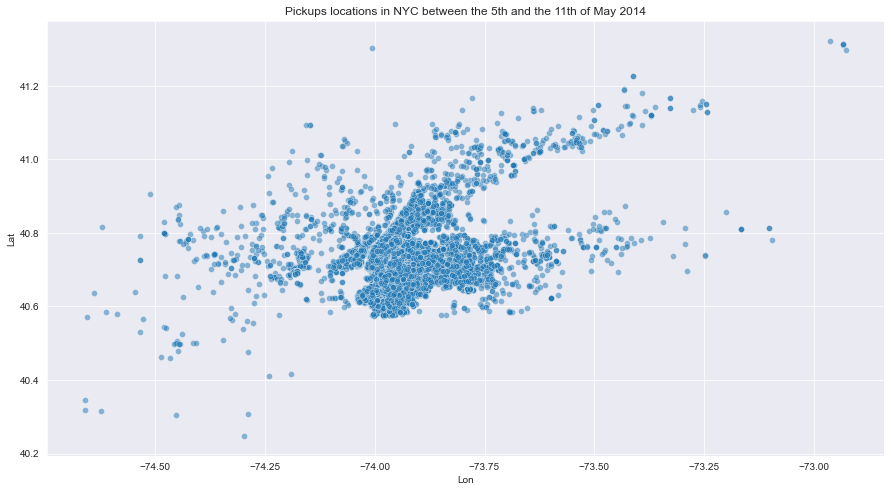

In [11]:
plt.figure(figsize=(15,8))
sns.scatterplot(data=may_2014, x='Lon', y='Lat', alpha=0.5).set_title('Pickups locations in NYC between the 5th and the 11th of May 2014')

Let's make a map to have a better understanding. We will create a heatmap with a timeslider to see the pickups density on the 5th of May 2014.

In [12]:
data_05052014 = may_2014[may_2014['date'].astype(str) == '2014-05-05'].copy()
data_05052014['Weight'] = 0.25

In [24]:
import folium
from folium.plugins import HeatMap, HeatMapWithTime

# Initialization of the map
m = folium.Map(location=[data_05052014['Lat'].mean(), data_05052014['Lon'].mean()],zoom_start = 11, tiles='cartodb positron') 

heat_data = []
range_hours = range(0,24)
for i in range_hours:
    data_hour = data_05052014[data_05052014['hour'] == i]
    coords_hour = list(map(list,zip(data_hour['Lat'],data_hour['Lon'])))
    heat_data.append(coords_hour)
    
HeatMapWithTime(heat_data, index=list(range_hours), auto_play=True).add_to(m)

m

# Model building 
Now we have to build a model to identify the hotzones per hour and per day. Let's start small and try to find the clusters for 05/05/2014 at 7pm. We will later generalise the model.
## Kmeans

In [18]:
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans

In [19]:
def find_optimal_clusters(X, min_clusters, max_clusters) :
    """ Function that helps finding the optimal number of cluster for Kmeans algorithm
    Parameters
    ----------
    X : Input features of the model
    min_clusters : minumum number of clusters to test
    max_clusters : maximum number of clusters to test
    
    Returns
    -------
    k : list of number of clusters tested
    wcss : Inertia for each cluster in k
    sil : Silhouette score for each cluster in k
    """
    
    wcss =  []
    sil = []
    k = []
    for i in range (min_clusters,max_clusters + 1): 
        kmeans = KMeans(n_clusters= i, init = "k-means++", random_state = 0)
        kmeans.fit(X)
        wcss.append(kmeans.inertia_)
        sil.append(silhouette_score(X, kmeans.predict(X)))
        k.append(i)
        print(f'K={i} --> WCSS is {wcss[-1]} and Silhouette score is {sil[-1]}')
    return k, wcss, sil

def plot_inertia_silhouette(k,wcss, sil):
    """ Function that takes the outputs of the find_optimal_clusters function and plot them
    Parameters
    ----------
    k : List of number of clusters
    wcss : Inertia for each cluster in k
    sil : Silhouette score for each cluster in k
    
    Returns
    -------
    A line plot for the Inertia per number of clusters and a line plot for the silhouette score per number of clusters 
    """
    
    fig, axes = plt.subplots(1, 2,figsize=(20,5))
    sns.lineplot(x=k, y=wcss, ax=axes[0])
    axes[0].set(xlabel='Number of clusters', ylabel='Inertia', title='Inertia per cluster')
    sns.lineplot(x=k, y=sil, ax=axes[1])
    axes[1].set(xlabel='Number of clusters', ylabel='Silhouette score', title='Silhouette score per cluster');
    

In [20]:
# Convert Lat/Lon to X/Y/Z coordinates for better distance calculation
data_2014['x'] = np.cos(data_2014['Lat']) * np.cos(data_2014['Lon'])
data_2014['y'] = np.cos(data_2014['Lat']) * np.sin(data_2014['Lon'])
data_2014['z'] = np.sin(data_2014['Lat']) 

In [21]:
# Filter the data
data_05052014_7pm = data_2014[(data_2014['date'].astype(str) == '2014-05-05') & (data_2014['hour'] == 19)].copy()
X = data_05052014_7pm[['x','y', 'z']].copy()

# Normalization
sc = StandardScaler()
X = sc.fit_transform(X.values)

K=2 --> WCSS is 2299.9606558571554 and Silhouette score is 0.7015782085664546
K=3 --> WCSS is 1595.7649913235518 and Silhouette score is 0.7170590784688644
K=4 --> WCSS is 1001.4717168816675 and Silhouette score is 0.48255188755053224
K=5 --> WCSS is 736.2908212932446 and Silhouette score is 0.5223248306830537
K=6 --> WCSS is 620.3867092267672 and Silhouette score is 0.5236146102667846
K=7 --> WCSS is 515.2279775148338 and Silhouette score is 0.528517476489639
K=8 --> WCSS is 414.1237600481297 and Silhouette score is 0.529591357308445
K=9 --> WCSS is 352.4214420991523 and Silhouette score is 0.5093709613043517
K=10 --> WCSS is 300.7666767412816 and Silhouette score is 0.4764499572905432


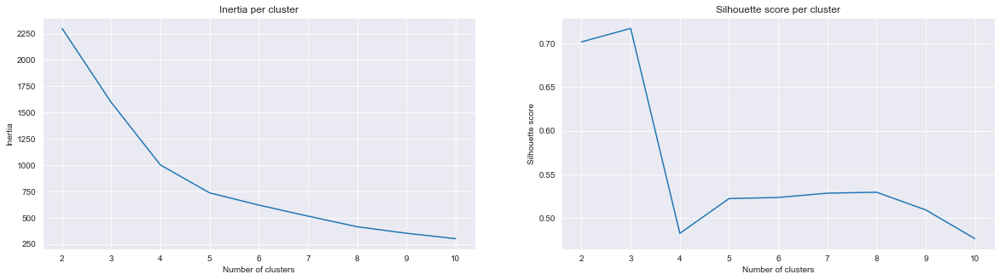

In [9]:
# Search for optimal number of clusters
k, wcss, sil = find_optimal_clusters(X, 2, 10)
plot_inertia_silhouette(k, wcss, sil)

Using the elbow methode, we can determine that the optimal number of clusters is 4 or 5. However the silhouette score for 5 clusters is higher than 4.

In [22]:
# 5 seams a good number of clusters but 8 could be good too
kmeans = KMeans(n_clusters=5, random_state=0, init="k-means++")
# Fit kmeans to our dataset

data_05052014_7pm['cluster_kmeans'] = kmeans.fit_predict(X)
data_05052014_7pm['cluster_kmeans'] = data_05052014_7pm['cluster_kmeans'].astype('str')

In [23]:
# Convert the dataframe to a geodataframe for plotting a map
geo_data_05052014_7pm = gpd.GeoDataFrame(data_05052014_7pm, geometry=gpd.points_from_xy(data_05052014_7pm.Lon, data_05052014_7pm.Lat), crs="EPSG:4326", columns=['Lat', 'Lon', 'cluster_kmeans'])
geo_data_05052014_7pm.explore(column='cluster_kmeans', tiles='CartoDB positron')

In [26]:
## Lets do the same for all mondays at 7pm
data_mondays_7pm = data_2014[(data_2014['weekday'] == 'Monday') & (data_2014['hour'] == 19)].copy()
X = data_mondays_7pm[['x', 'y', 'z']].copy()
sc = StandardScaler()
X = sc.fit_transform(X.values)

K=2 --> WCSS is 0.026780444880414707 and Silhouette score is 0.7217909603465733
K=3 --> WCSS is 0.020765678013905636 and Silhouette score is 0.39900391679526637
K=4 --> WCSS is 0.015731466621988478 and Silhouette score is 0.6618639508064172
K=5 --> WCSS is 0.011076428926360246 and Silhouette score is 0.4656513019830512
K=6 --> WCSS is 0.00889830804791065 and Silhouette score is 0.49071706473330506
K=7 --> WCSS is 0.007612662446366951 and Silhouette score is 0.4949824288059852
K=8 --> WCSS is 0.006661109619478798 and Silhouette score is 0.4888008229953822
K=9 --> WCSS is 0.00601614399848118 and Silhouette score is 0.5032386572685903
K=10 --> WCSS is 0.005408565335297025 and Silhouette score is 0.504692647992336


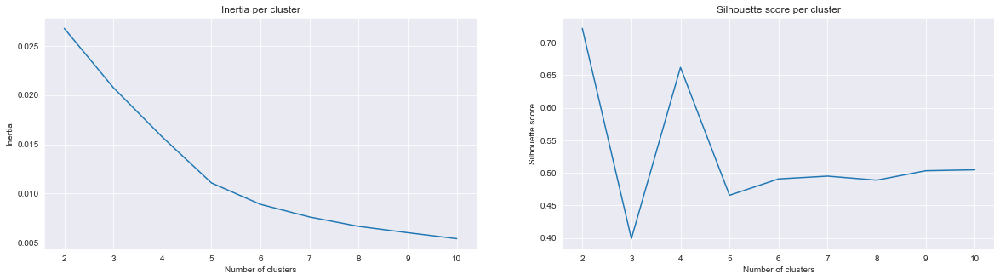

In [42]:
k, wcss, sil = find_optimal_clusters(X, 2, 10)
plot_inertia_silhouette(k, wcss, sil)

In [27]:
# 5 seems again a good number of clusters
kmeans = KMeans(n_clusters=5, random_state=0, init="k-means++")
# Fit kmeans to our dataset
data_mondays_7pm['cluster_kmeans'] = kmeans.fit_predict(X)
data_mondays_7pm['cluster_kmeans'] = data_mondays_7pm['cluster_kmeans'].astype('str')
geo_data_mondays_7pm = gpd.GeoDataFrame(data_mondays_7pm, geometry=gpd.points_from_xy(data_mondays_7pm.Lon, data_mondays_7pm.Lat), crs="EPSG:4326", columns=['Lat', 'Lon', 'cluster_kmeans'])
geo_data_mondays_7pm.explore(column='cluster_kmeans', tiles='CartoDB positron')

## DBSCAN
Now let's try using the DBSCAN algorithm. Here is a very good article on [clustering spatial data with DBSCAN](https://geoffboeing.com/2014/08/clustering-to-reduce-spatial-data-set-size/).  

In [29]:
from sklearn.cluster import DBSCAN
from sklearn import metrics

In [30]:
# Define the number of kilometers in one radian
kms_per_radian = 6371.0088

# Convert Lat/Lon to radians for use by haversine
X = np.radians(data_mondays_7pm[[ 'Lat', 'Lon']].values)

# define epsilon as 1.5 kilometers, converted to radians for use by haversine

epsilons = [1 / kms_per_radian, 1.5 / kms_per_radian, 2 / kms_per_radian, 2.5 / kms_per_radian, 3 / kms_per_radian]
min_samples = [10, 25, 50, 75, 100]

In [32]:
def find_optimal_hyperparameters(X, espilons, min_samples, metric) :
    """ Function that helps finding the optimal number of cluster for DBSCAN algorithm
    Parameters
    ----------
    X : Input features of the model
    epsilons : List of epsilons to test
    min_samples : List of min_samples to test
    metric : Metric to use when calculating distance
    
    Returns
    -------
    results : Dictionnary containing the silhouette score for each epsilon/min_sample combinaison
    """
    results= []
    for epsilon in espilons:
        for min_sample in min_samples :
            db = DBSCAN(eps=epsilon, min_samples=min_sample, algorithm='auto', metric=metric).fit(X)
            sil = silhouette_score(X, db.labels_)
            result = {'epsilon': epsilon, 'min_samples' : min_sample, 'silhouette' : sil}
            results.append(result)

            print(f'espilon={epsilon}, min_samples={min_sample} --> Silhouette score is {sil}')
    return results

In [33]:
sil_scores = find_optimal_hyperparameters(X,epsilons, min_samples, 'haversine')

espilon=0.00015696101377226163, min_samples=10 --> Silhouette score is 0.08187510878128255
espilon=0.00015696101377226163, min_samples=25 --> Silhouette score is 0.27501893121551113
espilon=0.00015696101377226163, min_samples=50 --> Silhouette score is 0.2746318578511119
espilon=0.00015696101377226163, min_samples=75 --> Silhouette score is 0.2678048522978439
espilon=0.00015696101377226163, min_samples=100 --> Silhouette score is 0.6378842488717825
espilon=0.00023544152065839246, min_samples=10 --> Silhouette score is 0.635317061792399
espilon=0.00023544152065839246, min_samples=25 --> Silhouette score is 0.7401233402695568
espilon=0.00023544152065839246, min_samples=50 --> Silhouette score is 0.7380680251598704
espilon=0.00023544152065839246, min_samples=75 --> Silhouette score is 0.7329437497426972
espilon=0.00023544152065839246, min_samples=100 --> Silhouette score is 0.7278115834507649
espilon=0.00031392202754452326, min_samples=10 --> Silhouette score is 0.6515211776419938
espilon

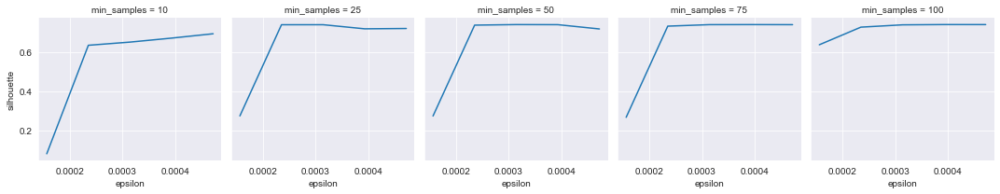

In [35]:
sil_scores = pd.DataFrame(sil_scores)
g = sns.FacetGrid(sil_scores, col='min_samples')
g.map(sns.lineplot, 'epsilon', 'silhouette')

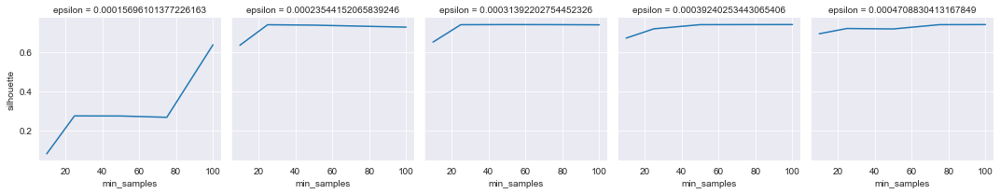

In [36]:
g = sns.FacetGrid(sil_scores, col='epsilon')
g.map(sns.lineplot, 'min_samples', 'silhouette')

Text(0.5, 0, 'silhouette')

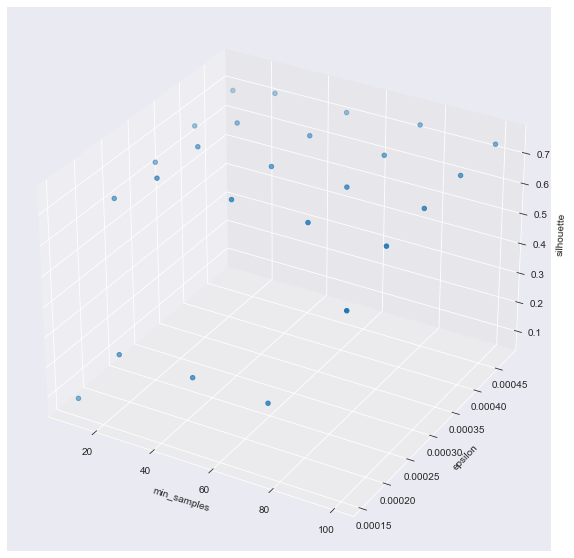

In [37]:
plt.figure(figsize=(10,10))
axes = plt.axes(projection='3d')
axes.scatter3D(sil_scores['min_samples'], sil_scores['epsilon'], sil_scores['silhouette'])
axes.set_xlabel('min_samples')
axes.set_ylabel('epsilon')
axes.set_zlabel('silhouette')

In [38]:
best_score_params = sil_scores.loc[sil_scores['silhouette'].idxmax()]
best_score_params

epsilon          0.000392
min_samples    100.000000
silhouette       0.741035
Name: 19, dtype: float64

In [39]:
db = DBSCAN(eps=best_score_params['epsilon'], min_samples=int(best_score_params['min_samples']), algorithm='auto', metric='haversine').fit(X)
cluster_labels = db.labels_

In [41]:
data_mondays_7pm['cluster_db'] = db.labels_
data_mondays_7pm['cluster_db'] = data_mondays_7pm['cluster_db'].astype('str')
geo_data_mondays_7pm = gpd.GeoDataFrame(data_mondays_7pm, geometry=gpd.points_from_xy(data_mondays_7pm.Lon, data_mondays_7pm.Lat), crs="EPSG:4326", columns=['Lat', 'Lon', 'cluster_db'])
geo_data_mondays_7pm.explore(column='cluster_db', tiles='CartoDB positron')

DBSCAN seems to do a slightly better job than Kmeans in our use case. It only finds 33 clusters, which might not be granular enough but the clusters seems more "natural" and the algorithm detected the outliers.

One problem with all the distance metrics in Scikitlearn is that none of them can detect natural obtascle. On the map, points each side of the rivers are all clustered together even if there is no easy way to ger from one point to the other. What if we try using a driving distance or driving time as a metric ? Let's try in the next section !

## DBSCAN with driving time matrix

### How to get the driving time matrix

To get the driving time between points, we will use the [OSMX] (https://osmnx.readthedocs.io/en/stable/) python library. 
We will need to follow the steps :
- Install the package
- Get the network of our study zone 
- Find the nearest node for each location of our dataset
- Calculate the driving time between points and create a distance matrix
- Fit the matrix to the DBSCAN algorithm

The 3 first steps takes a lot of time ! It is not realistic to be able to use it for our whole dataset. For this reason, we will only explore this method for pickups on the 5th of May between 7 and 8pm and using the driving travel time.

In [43]:
conda install -c conda-forge osmnx

Solving environment: done

## Package Plan ##

  environment location: /Users/marion/miniforge3

  added / updated specs:
    - osmnx


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    ca-certificates-2022.9.24  |       h4653dfc_0         150 KB  conda-forge
    certifi-2022.9.24          |     pyhd8ed1ab_0         155 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         305 KB

The following packages will be UPDATED:

  ca-certificates                      2022.9.14-h4653dfc_0 --> 2022.9.24-h4653dfc_0
  certifi                            2022.9.14-pyhd8ed1ab_0 --> 2022.9.24-pyhd8ed1ab_0



certifi-2022.9.24    | 155 KB    | ##################################### | 100% 
ca-certificates-2022 | 150 KB    | ##################################### | 100% 
Preparing transaction: done
Verifying transaction: done

In [44]:
import osmnx as ox

In [ ]:
# 1. Get the network - DO NOT RUN as it takes a lot of time. The network is already saved and can be simply loaded in the next cell
lat_min = data_2014['Lat'].min()
lat_max = data_2014['Lat'].max()
lon_min = data_2014['Lon'].min()
lon_max = data_2014['Lon'].max()

ox.config(timeout=10000)
G = ox.graph_from_bbox(lat_max, lat_min,lon_max, lon_min, network_type='drive')
Gp = ox.project_graph(G)
ox.plot_graph(G)

## impute speed on all edges missing data
G = ox.add_edge_speeds(G)

## calculate travel time (seconds) for all edges
G = ox.add_edge_travel_times(G)

## save the network grpah for later use
ox.save_graphml(G, filepath='graph_nyc.graphml')

In [45]:
from zipfile import ZipFile

zip_network = ZipFile('graph_nyc.graphml.zip', 'r')
zip_network.extractall()
G = ox.load_graphml('graph_nyc.graphml')

In [ ]:
# 2. Find the closest node for each record in our dataframe- DO NOT RUN as it takes a lot of time. The nodes are already saved and can be loaded in the next cell
data_05052014_7pm = data_2014[(data_2014['date'].astype(str) == '2014-05-05') & (data_2014['hour'] == 19)].copy()
list_coords =list(zip(data_05052014_7pm['Lon'],data_05052014_7pm['Lat']))
nodes = [ox.nearest_nodes(G, coord[0], coord[1]) for coord in list_coords]
nodes = [[node] for node in nodes]
np.array(nodes).dump('nodes')

In [46]:
nodes = np.load('nodes', allow_pickle=True)

In [48]:
def get_time_travel (origine_node, destination_node):
    """ Function that get the travel time between two nodes
    Parameters
    ----------
    origine_node : Origine node in the G OSMX network
    destination_node : Destination node in the G OSMX network
    
    Returns
    -------
    travel_time : the travel time in seconds by car between the origine and destination node
    """
    route = ox.shortest_path(G, origine_node[0], destination_node[0], weight="travel_time")
    if route:
        travel_time = int(sum(ox.utils_graph.get_route_edge_attributes(G, route, "travel_time")))
    else:
        travel_time = 10000 # Just affect a high travel time so the points are not considered as "neighbours" by the cluster algrorithm
    return travel_time

In [ ]:
# Calculate the driving time matrix. DO NOT RUN as it takes a lot of time!
distances_matrix = pairwise_distances(X=nodes,metric=get_time_travel)
distances_matrix.dump('distances_matrix')

### Model training

In [49]:
# X is now our own distance matrix. We we will the 'precomputed' metric for DBSCAN
X = np.load('distances_matrix', allow_pickle=True)

epsilons = [120, 180, 240, 300, 360, 420]
min_samples = [10, 25, 50, 75, 100]

espilon=120, min_samples=10 --> Silhouette score is -0.14992557692791628
espilon=120, min_samples=25 --> Silhouette score is -0.1209834987551959
espilon=120, min_samples=50 --> Silhouette score is -0.08528569822672677
espilon=120, min_samples=75 --> Silhouette score is -0.08767755501881225
espilon=120, min_samples=100 --> Silhouette score is -0.09125115917346951
espilon=180, min_samples=10 --> Silhouette score is -0.059577706720312984
espilon=180, min_samples=25 --> Silhouette score is -0.13680095158017197
espilon=180, min_samples=50 --> Silhouette score is -0.08730176252073356
espilon=180, min_samples=75 --> Silhouette score is -0.08627117619327843
espilon=180, min_samples=100 --> Silhouette score is -0.0860559564181678
espilon=240, min_samples=10 --> Silhouette score is 0.531432318829112
espilon=240, min_samples=25 --> Silhouette score is -0.1295746652569975
espilon=240, min_samples=50 --> Silhouette score is -0.09657145204374325
espilon=240, min_samples=75 --> Silhouette score is -0

Text(0.5, 0, 'silhouette')

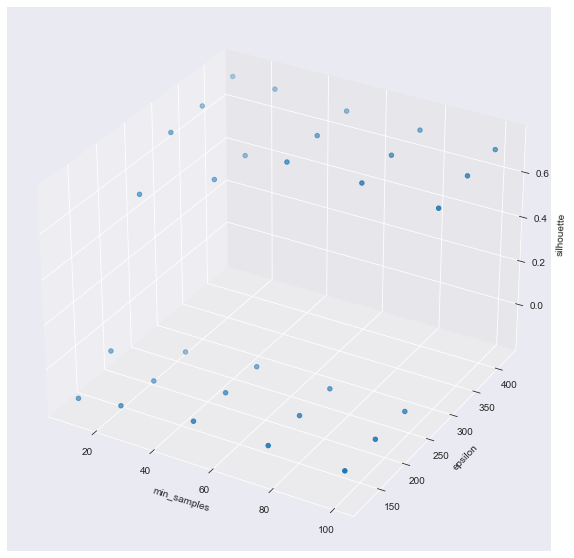

In [50]:
# Find the best parameters
sil_scores = find_optimal_hyperparameters(X,epsilons, min_samples, 'precomputed')
sil_scores = pd.DataFrame(sil_scores)

plt.figure(figsize=(10,10))
axes = plt.axes(projection='3d')
axes.scatter3D(sil_scores['min_samples'], sil_scores['epsilon'], sil_scores['silhouette'])
axes.set_xlabel('min_samples')
axes.set_ylabel('epsilon')
axes.set_zlabel('silhouette')

In [51]:
best_score_params = sil_scores.loc[sil_scores['silhouette'].idxmax()]
best_score_params

epsilon        420.000000
min_samples     10.000000
silhouette       0.739625
Name: 25, dtype: float64

In [52]:
db = DBSCAN(eps=180, min_samples=int(best_score_params['min_samples']), metric='precomputed').fit(X)
cluster_labels = db.labels_

In [53]:
data_05052014_7pm['cluster_tt'] = db.labels_
data_05052014_7pm['cluster_tt'] = data_05052014_7pm['cluster_tt'].astype('str')
geo_data_05052014_7pm = gpd.GeoDataFrame(data_05052014_7pm, geometry=gpd.points_from_xy(data_05052014_7pm.Lon, data_05052014_7pm.Lat), crs="EPSG:4326", columns=['Lat', 'Lon', 'cluster_tt'])
geo_data_05052014_7pm.explore(column='cluster_tt', tiles='CartoDB positron')

Yeah that looks much better ! Points each side of the East river are now in their own cluster. This method creates more realistic and more granular clusters. Unfortunately, the computation time doesn't allow us to apply it on the whole dataset. 

# Generalisation
Now let's generalise the model for the whole 2014 dataset. We will create clusters for each hour per weekday.
The cell below does a few things. For each hour and weekday it :
- Creates clusters using Kmeans
- Creates cluasters using DBSCAN
- Save the results in the csv file
- Create clusters boundaries (only for DBSCAN clusters)
- Convert them to Geojson for later use by the Folium TimestampedGeoJson plugin and save it

In [55]:
import json

In [ ]:
features = []
weekdays_dict = {'Monday' : '01', 'Tuesday' : '02', 'Wednesday' : '03', 'Thursday' : '04', 'Friday' : '05', 'Saturday' : '06', 'Sunday' : '07'}
colors_dict = {0 : 'red', 1: 'blue', 2 : 'green', 3 :'yellow', 4: 'black', 5 : 'purple'}

for weekday in ['Monday','Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'] :
    for hour in range (0, 24):
        data = data_2014[(data_2014['weekday'] == weekday) & (data_2014['hour'] == hour)].copy()
        
        # Preparing X for Kmeans
        X_kmeans = data[['x','y', 'z']]
        sc = StandardScaler()
        X_kmeans = sc.fit_transform(X_kmeans.values)
        
        # Preparing X for DbScan
        X_db = np.radians(data[[ 'Lat', 'Lon']].values)
        
        # Fitting both models
        print(f'Fitting {weekday} at {str(hour)}')
        
        kmeans = KMeans(n_clusters=5, random_state=0, init="k-means++")
        data['cluster_kmeans'] = kmeans.fit_predict(X_kmeans)
        
        db = DBSCAN(eps=0.000392, min_samples=25, algorithm='auto', metric='haversine').fit(X_db)
        data['cluster_db'] = db.labels_
        
        # Save results to csv
        data.to_csv(f'results/{weekday}_{str(hour)}.csv')
        
        # Create dbscan clusters polygons from points
        geo_data = gpd.GeoDataFrame(data, geometry=gpd.points_from_xy(data.Lon, data.Lat), crs="EPSG:4326", columns=['Lat', 'Lon', 'cluster_db'])
        geo_data = geo_data[geo_data['cluster_db'] != -1]
        clusters_db = (geo_data.dissolve(by='cluster_db').convex_hull.reset_index().set_geometry(0))
        
        # Convert to Geojson format for use of the TimestampedGeoJson plugin
        str_hour = f'0{str(hour)}' if len(str(hour)) == 1   else str(hour)
        clusters_db['time'] = f'2022-01-{weekdays_dict[weekday]} {str_hour}:00:00'
        clusters_db['color'] = clusters_db['cluster_db'].apply(lambda x : colors_dict[x])
        clusters_db = json.loads(clusters_db.to_json())
        
        for cluster in clusters_db['features']:
            feature = {
                'type' : 'Feature',
                'geometry' : cluster['geometry'],
                'properties' : {
                    'popup' : cluster['properties']['cluster_db'],
                    'time' : cluster['properties']['time'],
                    'style': {
                        'color': cluster['properties']['color']
                    }
                }

            }
            features.append(feature)

            
features_geojson = {
    'type': 'FeatureCollection',
    'features': features
}

with open('features.geojson', "w") as outfile:
    json.dump(features_geojson, outfile)       

Let's display our DBSCAN clusters on a pretty map !

In [57]:
from folium.plugins import TimestampedGeoJson

with open('features.geojson', 'r') as read_content:
    features_geojson = json.load(read_content)

m = folium.Map(location=[data_2014['Lat'].mean(), data_2014['Lon'].mean()],zoom_start = 9, tiles='CartoDB positron') 

TimestampedGeoJson(
    features_geojson,
    auto_play=False,
    loop=False,
    #max_speed=1,
    period='PT1H',
    loop_button=True,
    date_options='HH:mm',
    time_slider_drag_update=True,
    duration='PT0H').add_to(m)
m.save('clusters_db.html')
m